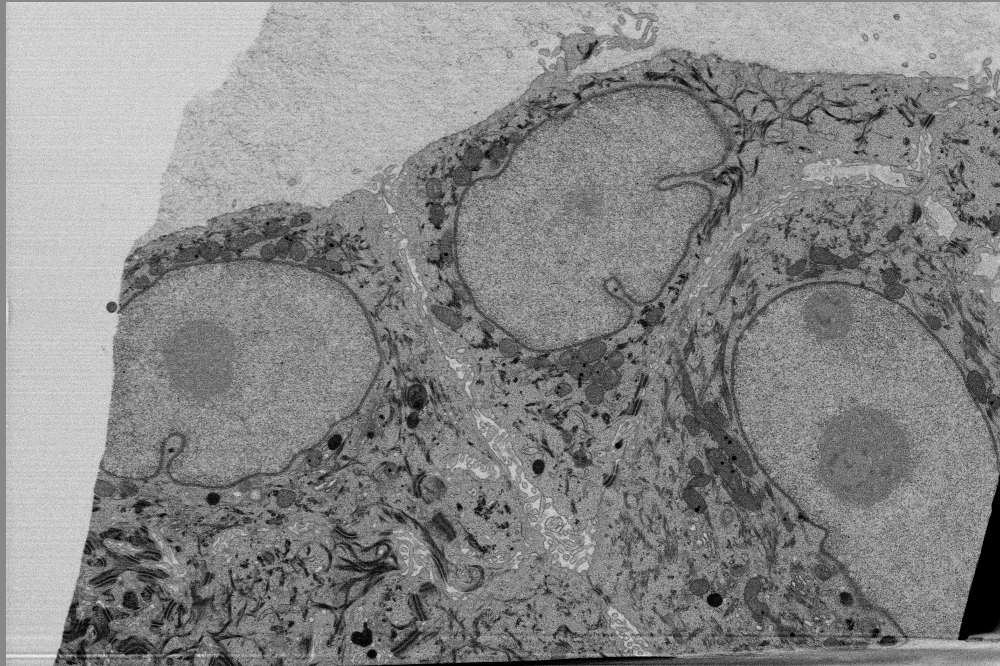

In [7]:
import cv2
import os
import numpy as np
from PIL import Image

S1 = 'D://repos//UTexas//microscopy//data//S1//S1_Helios_1of3_v1'

slide = os.path.join(S1,'S1_Helios_1of3_v1010.tiff')

img = Image.open(s010)
imarray = np.array(img)
img
# img.show()

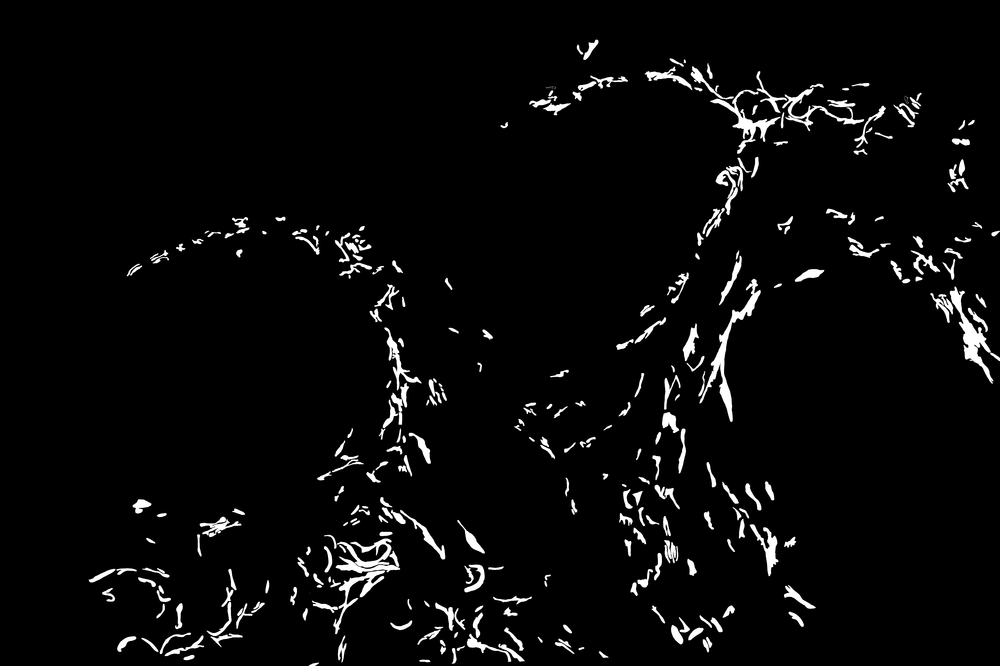

In [14]:
Cyto = Image.open(os.path.join(S1,'S1_Helios_1of3_v1010_Cytoskeleton.tiff'))

c_array = np.array(Cyto)
# np.sum(c_array)
c_array[c_array==1]=255
Cyto = Image.fromarray(c_array)
Cyto

(4096, 6144, 3)


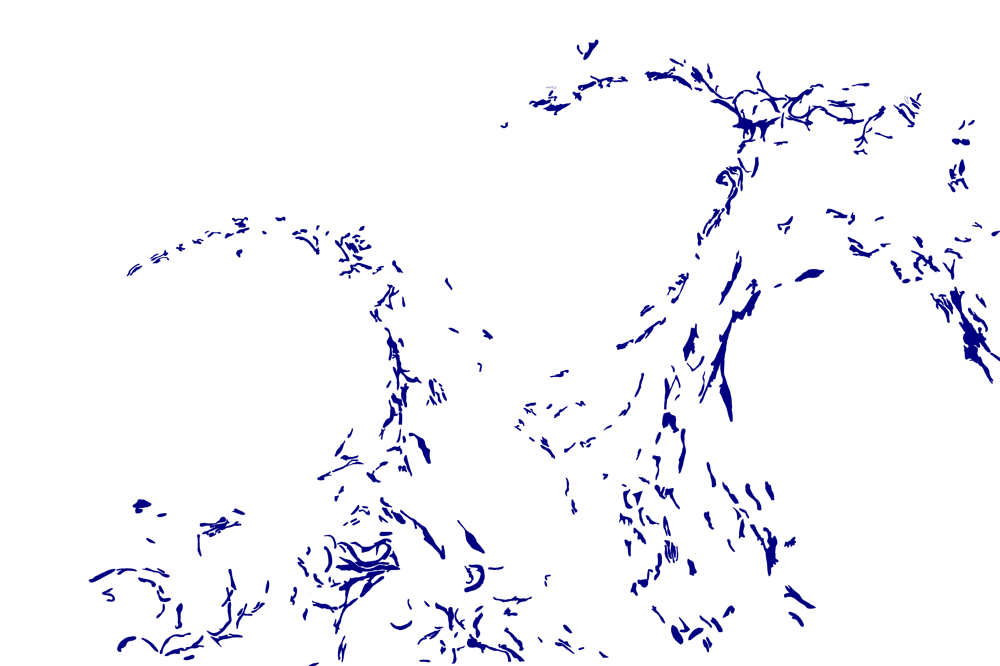

In [47]:
# import cv2
# rgb_cytp = cv2.cvtColor(Cyto,cv2.COLOR_GRAY2BGR)
import webcolors
tmp = Image.new('RGB',(Cyto.size),color='white')
tmp_array = np.array(tmp)
print(tmp_array.shape)


tmp_array[c_array==255] = webcolors.name_to_rgb('navy')

tmp = Image.fromarray(tmp_array)
tmp

In [82]:
import webcolors
category = ['PlasmaMembrane','NuclearMembrane','MitochondriaDark','MitochondriaLight','Desmosome','Cytoskeleton','LipidDroplet']
color = ['orange','navy','green','azure','red','yellow','pink']

dataset = 'D://repos//UTexas//microscopy//data//T4R//'
slides = os.listdir(dataset)
save_dir = '../data/T4R/'

for slide in slides:

    raw = Image.open(os.path.join(dataset,slide,slide+'.tif'))
#     raw_array = np.array(raw,dtype='int16')
#     raw = Image.fromarray(raw_array)
#     raw.save(save_dir+slide+'.png',format='png')


    tmp = Image.new('RGB',(raw.size),color='grey')
    tmp_array = np.array(tmp)
    print(tmp_array.shape)
#     del raw

    for i in category:
        try:
            organ = Image.open(os.path.join(dataset,slide,f'{slide}_{i}.tiff'))
            organ_array = np.array(organ)
            organ_array[organ_array==1]=255
            organ = Image.fromarray(organ_array)

            tmp_array[organ_array==255] = webcolors.name_to_rgb(color[category.index(i)])

            print(i)
            print(organ.dtype)
            organ.save(save_dir+slide+f'_{i}.jpg',format='jpg')
        except:
            continue

    tmp = Image.fromarray(tmp_array)
    tmp.save(save_dir+slide+f'_organells.png',format='png')


(7248, 7248, 3)
PlasmaMembrane
NuclearMembrane
MitochondriaDark
MitochondriaLight
Desmosome
Cytoskeleton
LipidDroplet
(7859, 7859, 3)
NuclearMembrane
MitochondriaDark
MitochondriaLight
Desmosome
Cytoskeleton
(6471, 6472, 3)
PlasmaMembrane
NuclearMembrane
MitochondriaDark
MitochondriaLight
Cytoskeleton
LipidDroplet
(6543, 6543, 3)
PlasmaMembrane
NuclearMembrane
MitochondriaDark
Desmosome
Cytoskeleton
LipidDroplet
(6982, 6999, 3)
NuclearMembrane
MitochondriaDark
MitochondriaLight
Desmosome
Cytoskeleton
(7113, 7097, 3)
PlasmaMembrane
NuclearMembrane
MitochondriaDark
MitochondriaLight
Desmosome
Cytoskeleton
LipidDroplet


[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(7568, 7700)
